In [60]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from IPython.display import display

# Load data

In [61]:
df=pd.read_pickle(r"C:\data science\data-science-template-main\data\interim\01_data_processed.pkl")

# Plot single columns

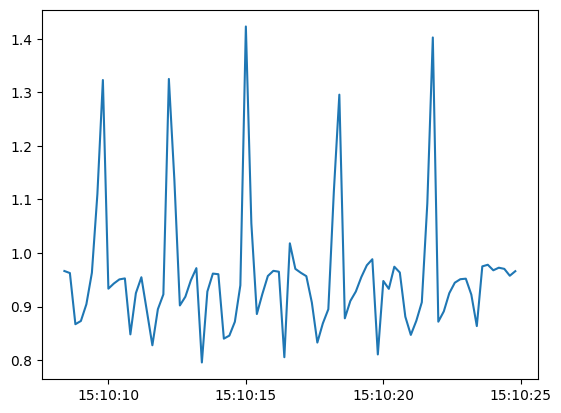

In [62]:
set_df=df[df["set"]==1]
plt.plot(set_df["acc_y"])


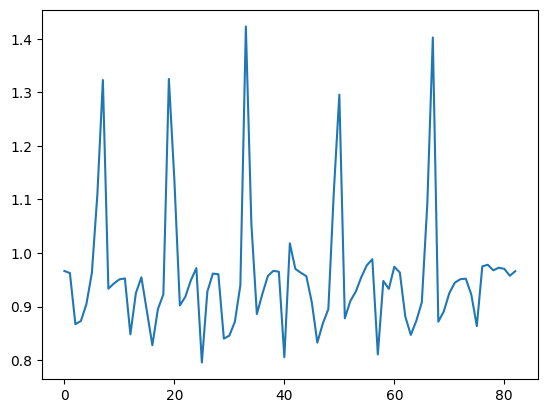

In [63]:
plt.plot(set_df["acc_y"].reset_index(drop=True))

# Plot all exercises

In [64]:
df["label"].unique()
df.head(2)

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.0135,0.9770,-0.0710,-1.8904,2.4392,0.9388,B,bench,heavy,30
2019-01-11 15:08:05.400,-0.0015,0.9705,-0.0795,-1.6826,-0.8904,2.1708,B,bench,heavy,30


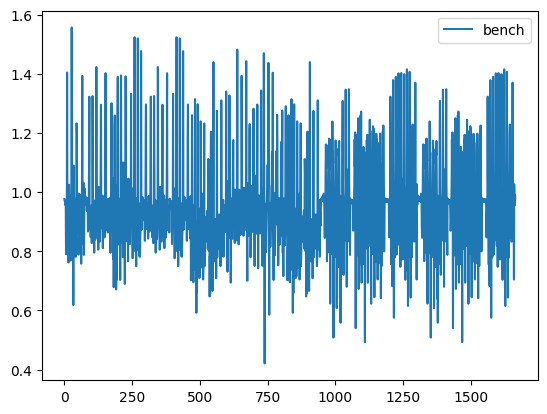

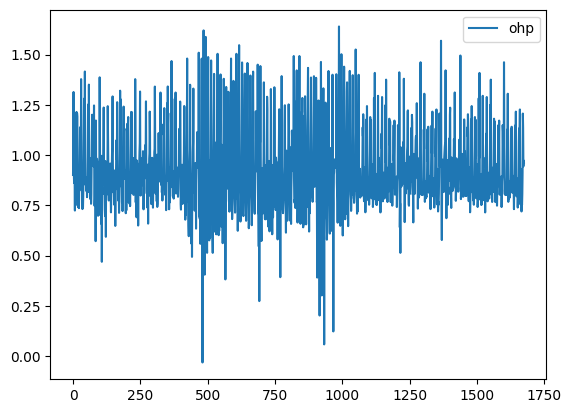

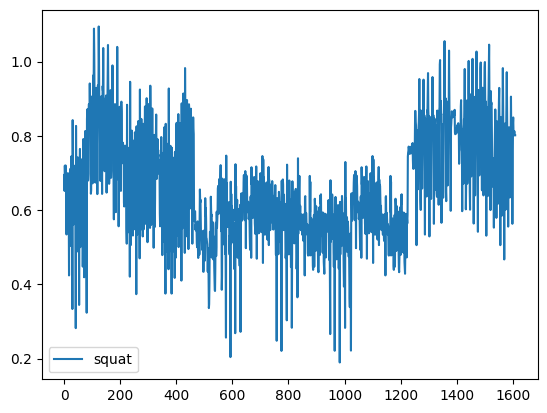

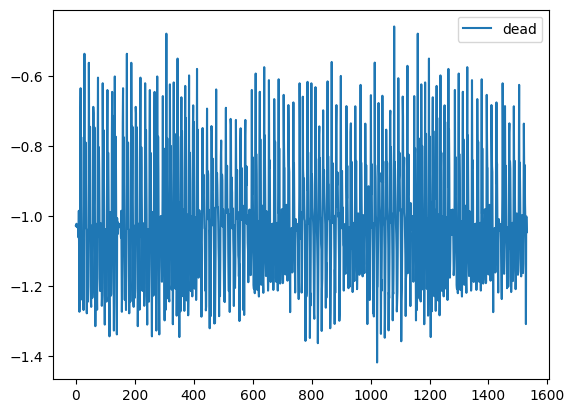

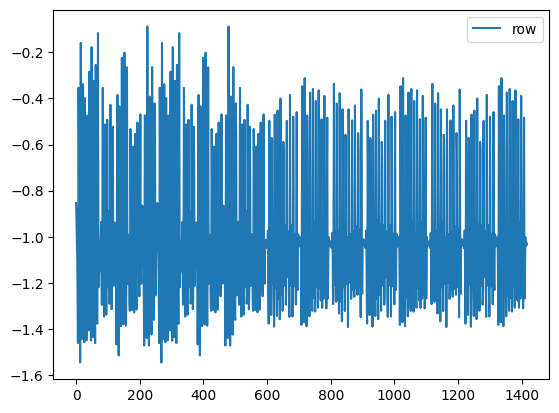

...

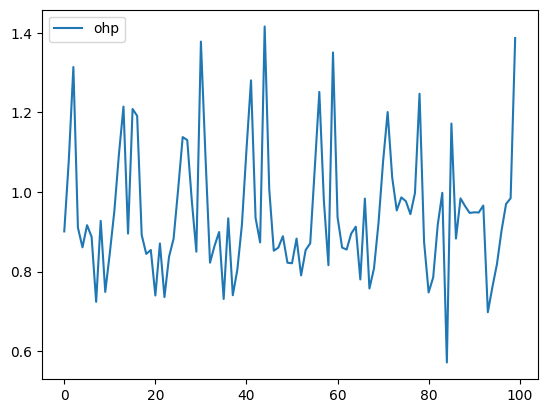

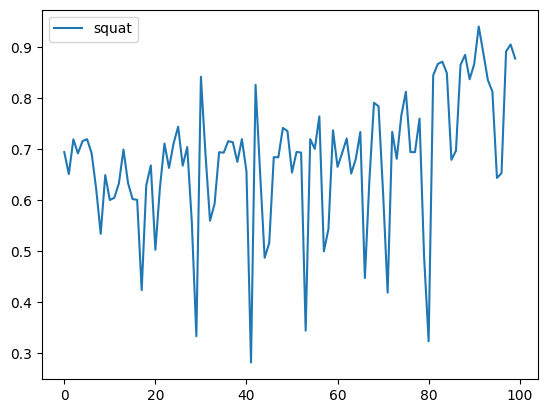

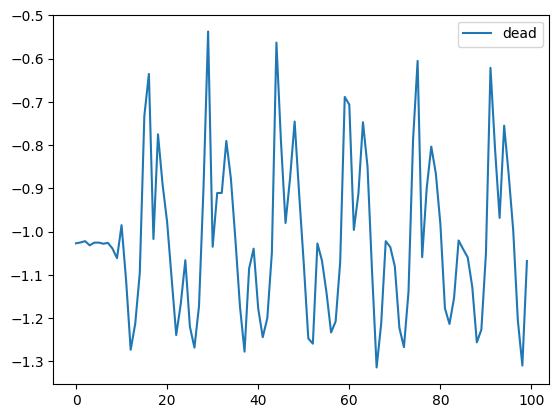

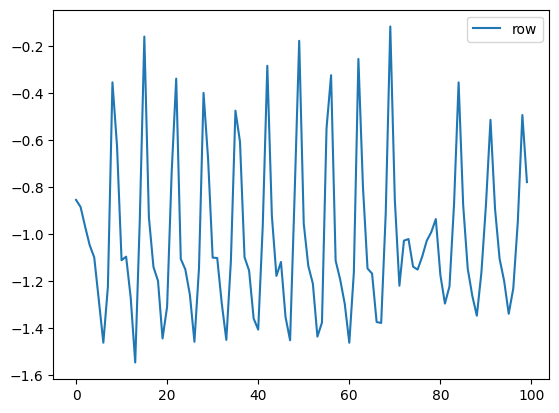

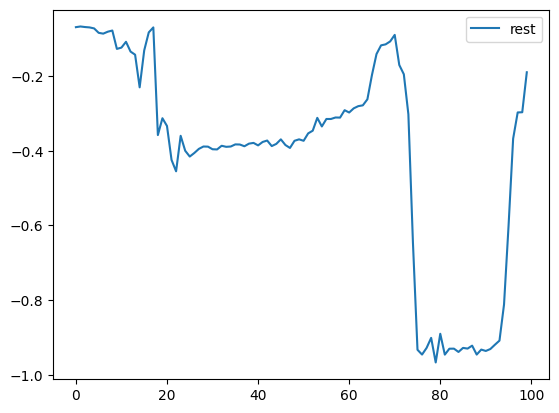

In [65]:
# Loop 1: Plot the ENTIRE duration for each exercise label
for label in df["label"].unique():
    
    # Filter the data to isolate only the current exercise (e.g., "squat")
    subset = df[df["label"] == label]
    
    fig, ax = plt.subplots()
    
    # Plot the full Y-axis acceleration data
    plt.plot(subset["acc_y"].reset_index(drop=True), label=label)
    
    plt.legend()
    plt.show()

# ---------------------------------------------------------

# Loop 2: Plot only the FIRST 100 samples (approx. 20 seconds) 
# This is better for seeing the specific "wave pattern" of the reps
for label in df["label"].unique():
    
    subset = df[df["label"] == label]
    
    fig, ax = plt.subplots()
    
    # Slice [:100] to zoom in on the start of the set
    plt.plot(subset[:100]["acc_y"].reset_index(drop=True), label=label)
    
    plt.legend()
    plt.show()

#Adjust plot settings

In [66]:
import matplotlib as mpl
import matplotlib.pyplot as plt

# 1. Set the visual style to a specific Seaborn theme
mpl.style.use("seaborn-v0_8-deep")

# 2. Set the default figure size (Width, Height) in inches
# (20, 5) creates a wide, panoramic layout perfect for time-series
mpl.rcParams["figure.figsize"] = (20, 5)

# 3. Set the resolution (Dots Per Inch)
# 100 is standard for screen display; higher values are for print
mpl.rcParams["figure.dpi"] = 100


# Compare medium vs. heavy sets

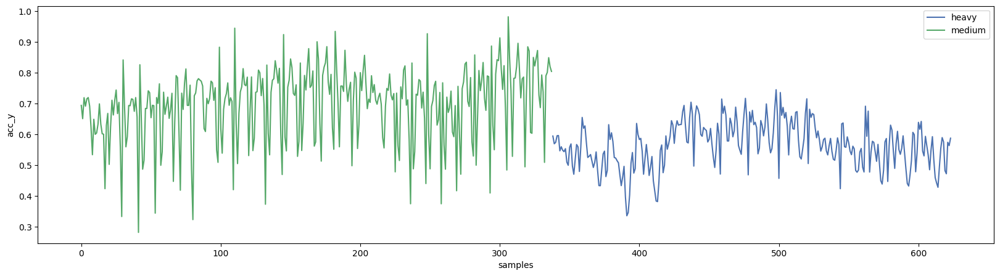

In [67]:
# 1. Filter the data: Select only 'squat' rows for participant 'A'
# .reset_index() creates a generic 0, 1, 2... index for this new subset
category_df = df.query("label == 'squat'").query("participant == 'A'").reset_index()

# 2. Initialize the plot figure
fig, ax = plt.subplots()

# 3. Plot the Y-axis acceleration, grouped by "category" (heavy vs medium)
# Pandas will automatically draw a separate line (with a different color) for each category
category_df.groupby(["category"])["acc_y"].plot()

# 4. Add labels and legend
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

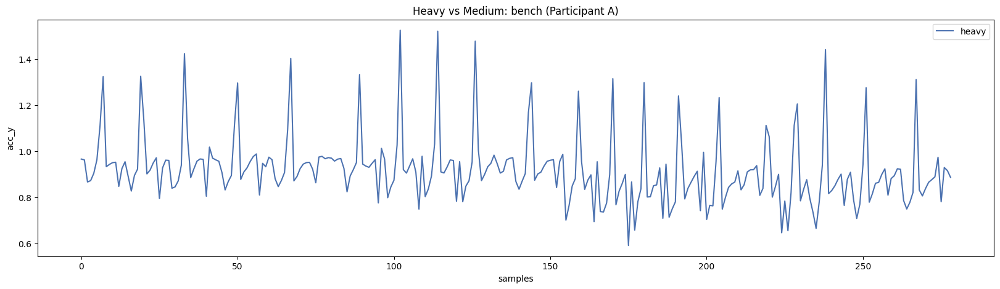

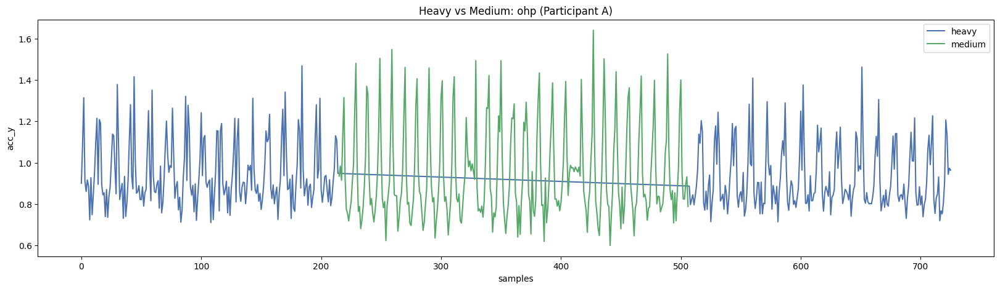

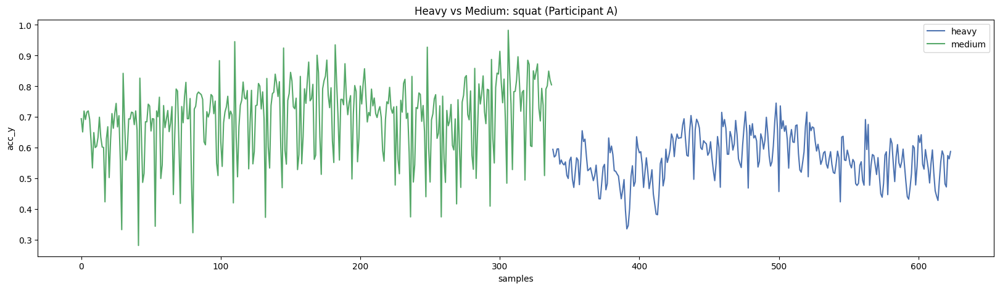

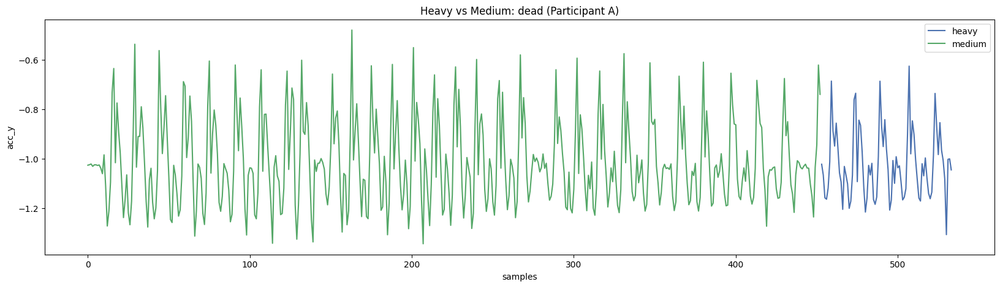

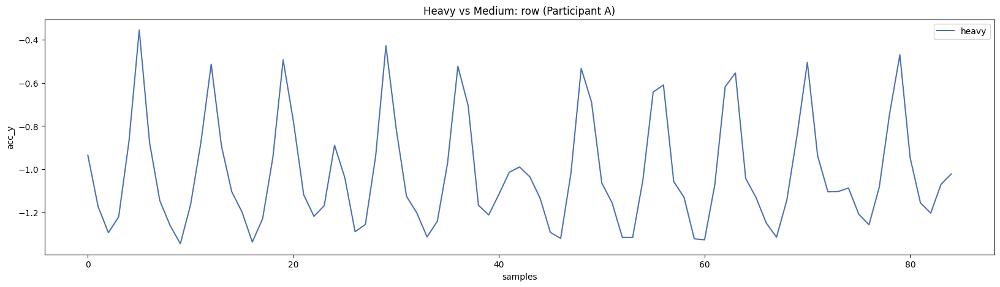

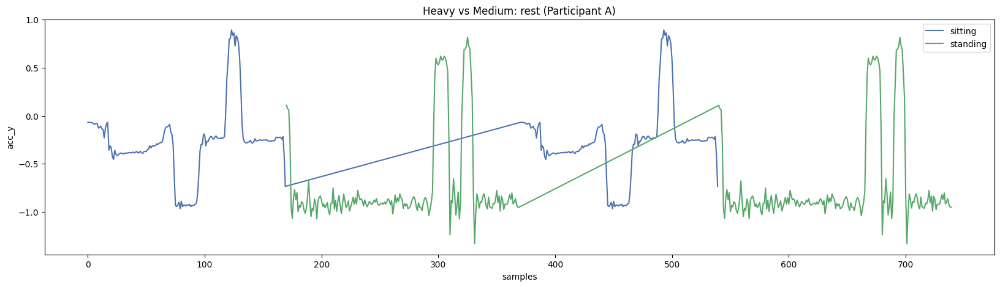

In [68]:
# Loop through every unique exercise label (squat, bench, etc.)
for label in df["label"].unique():
    
    # 1. Filter: Select the current label AND Participant 'A'
    # We use f-string f"label == '{label}'" to insert the variable into the query
    subset = df.query(f"label == '{label}'").query("participant == 'A'").reset_index()
    
    # Check if we actually have data for this combination (e.g., maybe Participant A didn't do 'row')
    if not subset.empty:
        
        # 2. Initialize a new figure for this exercise
        fig, ax = plt.subplots()
        
        # 3. Plot the Y-axis acceleration, grouped by "category" (heavy vs medium)
        subset.groupby(["category"])["acc_y"].plot(ax=ax)
        
        # 4. Add labels, title, and legend
        ax.set_ylabel("acc_y")
        ax.set_xlabel("samples")
        ax.set_title(f"Heavy vs Medium: {label} (Participant A)")
        plt.legend()
        plt.show()

# Compare participants


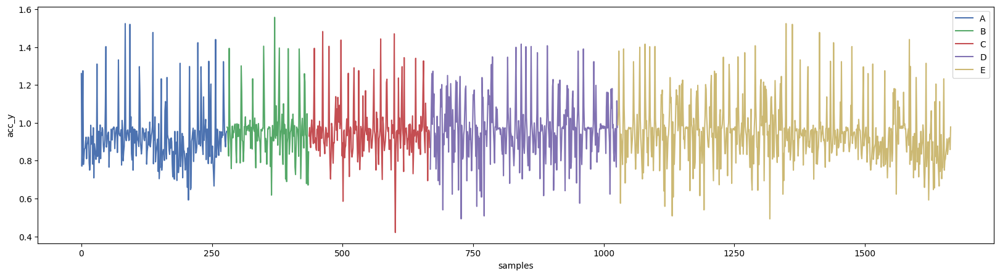

In [69]:
# 1. Filter for "bench" press only, sort by participant (A, B, C...), and reset index
participant_df = df.query("label == 'bench'").sort_values("participant").reset_index()

# 2. Initialize the plot
fig, ax = plt.subplots()

# 3. Group by participant and plot the Y-axis acceleration
# This automatically draws one line per participant on the same chart
participant_df.groupby(["participant"])["acc_y"].plot()

# 4. Label the axes and show the legend
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

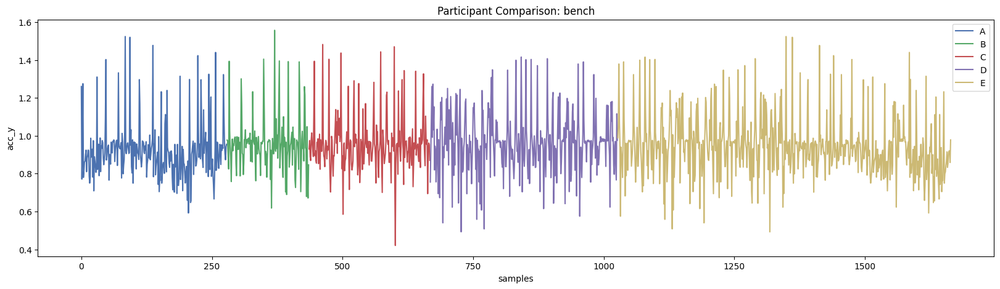

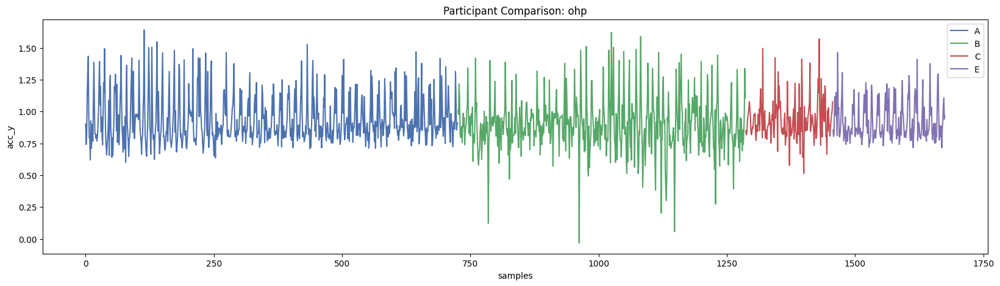

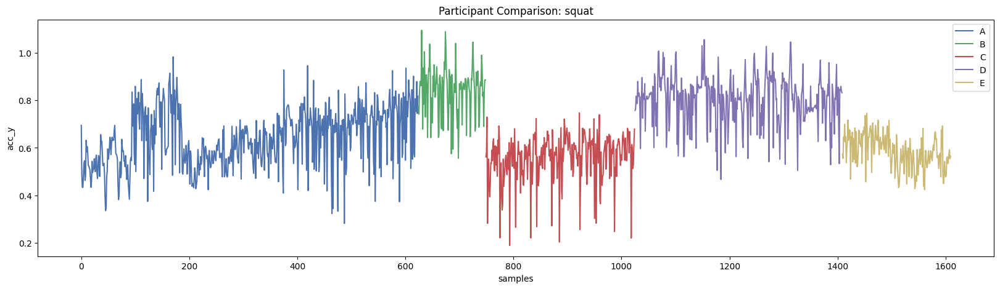

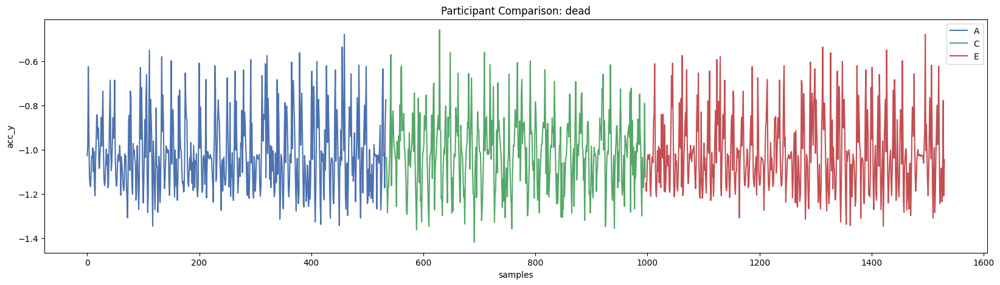

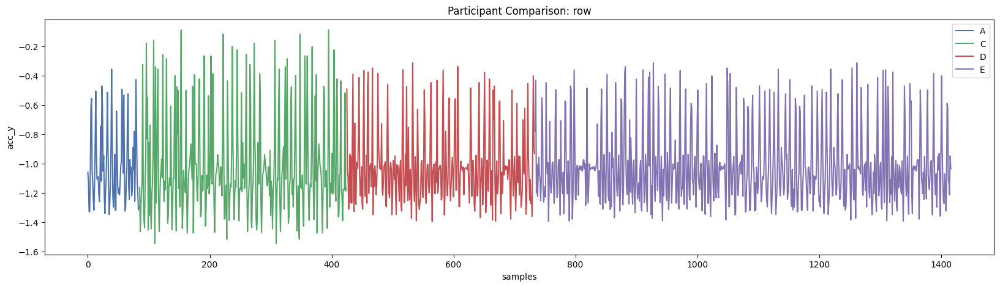

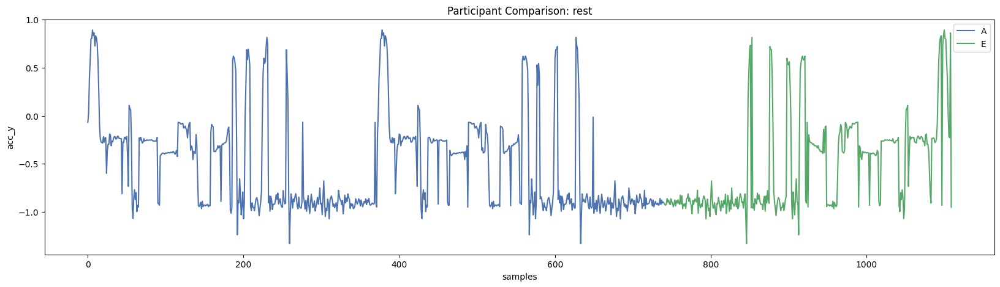

In [70]:
# Loop through every unique exercise label (squat, bench, etc.)
for label in df["label"].unique():
    
    # 1. Filter: Select the current label AND sort by participant
    # We use f-string to dynamically insert the current 'label' into the query
    subset = df.query(f"label == '{label}'").sort_values("participant").reset_index()
    
    # Check if we have data (good practice when looping)
    if not subset.empty:
        
        # 2. Initialize a new figure for this exercise
        fig, ax = plt.subplots()
        
        # 3. Plot the Y-axis acceleration, grouped by "participant"
        # This draws one line per participant (A, B, C...) on the same chart
        subset.groupby(["participant"])["acc_y"].plot(ax=ax)
        
        # 4. Add labels, title, and legend
        ax.set_ylabel("acc_y")
        ax.set_xlabel("samples")
        ax.set_title(f"Participant Comparison: {label}")
        plt.legend()
        plt.show()

# Plot multiple axis

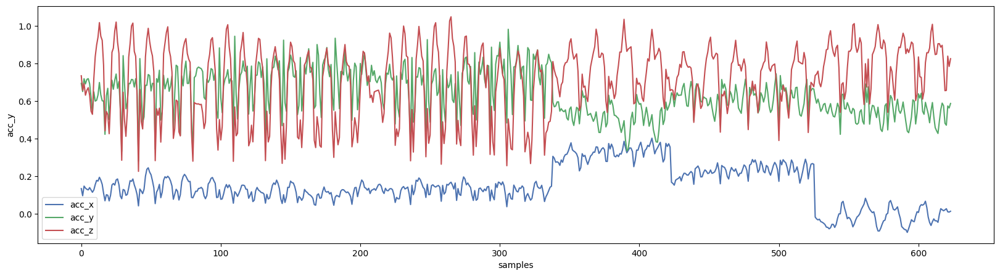

In [71]:
label = "squat"
participant = "A"

# 1. Filter: Select 'squat' rows for participant 'A'
# We use f-strings to insert the variables defined above
all_axis_df = df.query(f"label == '{label}'").query(f"participant == '{participant}'").reset_index()

# 2. Initialize the plot
fig, ax = plt.subplots()

# 3. Plot X, Y, and Z axes together
# We select all three columns and plot them on the same axis
all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax)

# 4. Add labels and legend
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()
plt.show()

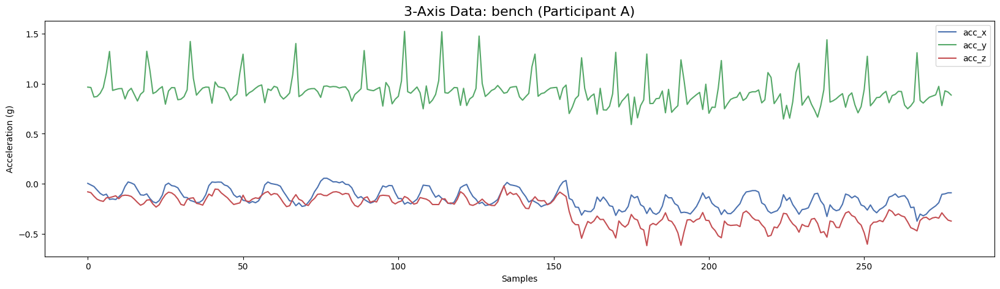

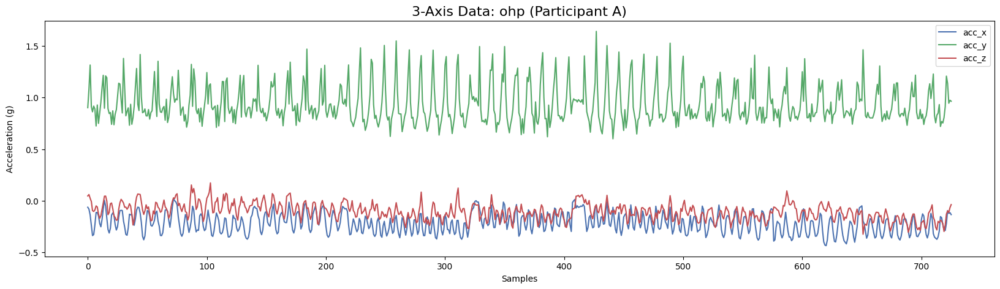

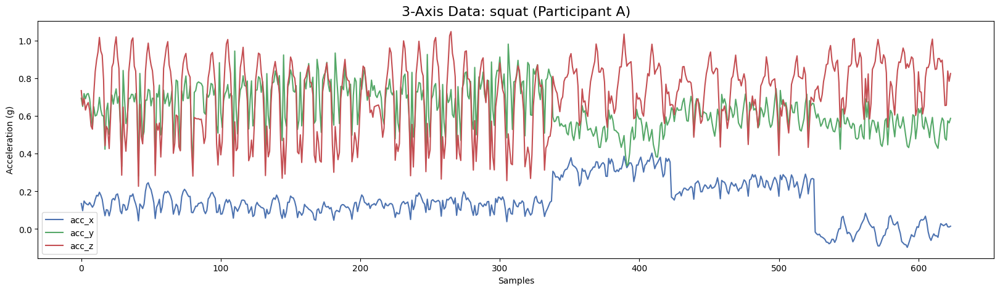

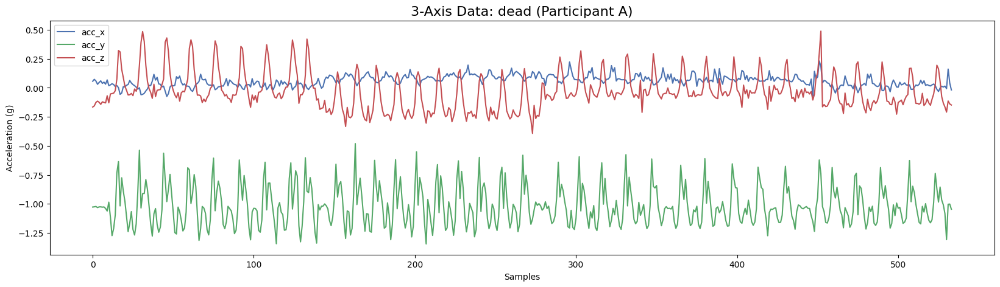

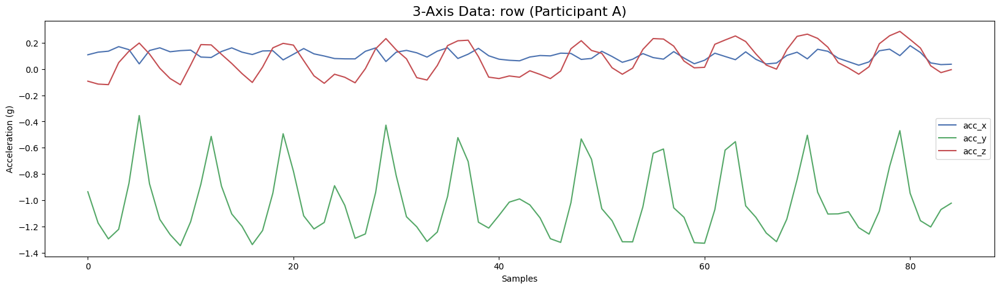

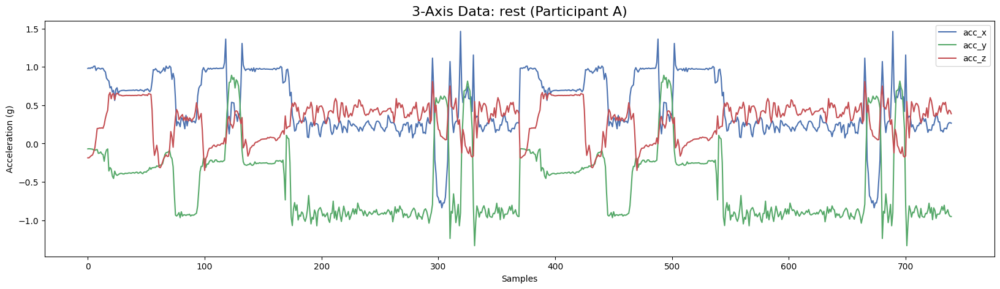

In [72]:
# Loop over every unique exercise (Squat, Bench, etc.)
for label in df["label"].unique():
    
    # 1. Filter: Select the current label (and Participant A for clarity)
    subset = df.query(f"label == '{label}'").query("participant == 'A'").reset_index()
    
    # Check if data exists for this combination
    if not subset.empty:
        fig, ax = plt.subplots()
        
        # 2. Plot X, Y, and Z columns together
        # Pandas automatically adds 'acc_x', 'acc_y', 'acc_z' to the legend
        subset[["acc_x", "acc_y", "acc_z"]].plot(ax=ax)
        
        # 3. Add Title (Labeling the plot) and Axis Labels
        ax.set_title(f"3-Axis Data: {label} (Participant A)", fontsize=16)
        ax.set_ylabel("Acceleration (g)")
        ax.set_xlabel("Samples")
        
        # 4. Show the plot
        plt.legend()
        plt.show()

# Create a loop to plot all combinations per sensor

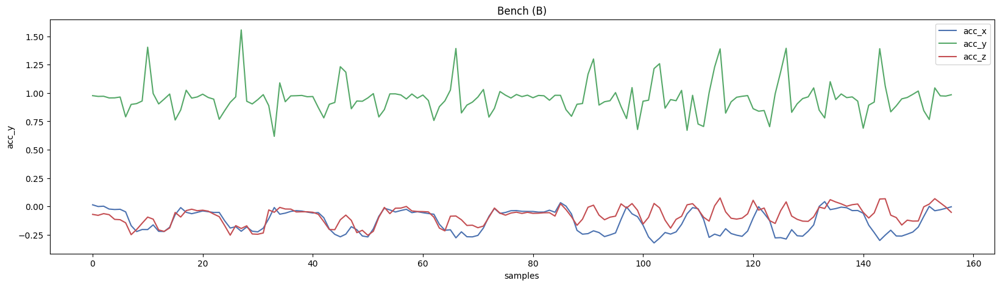

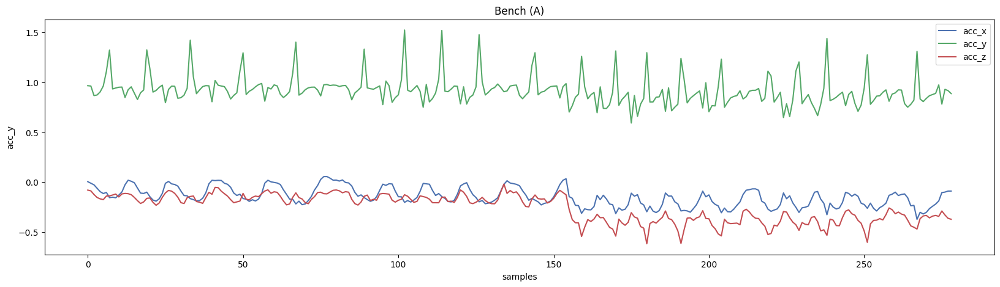

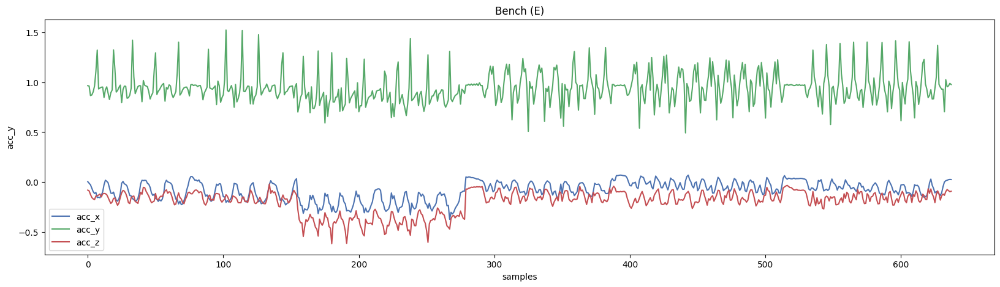

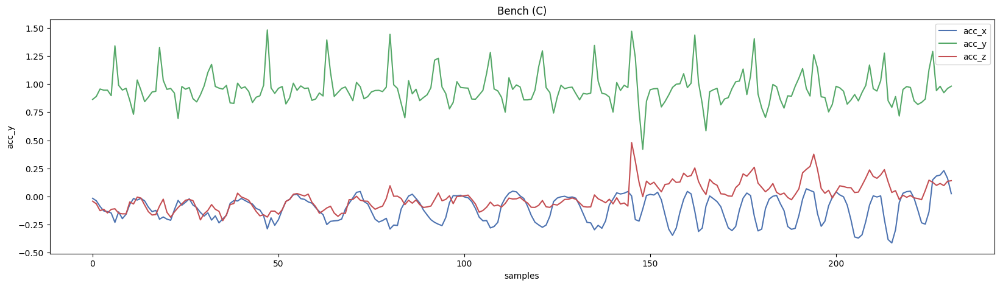

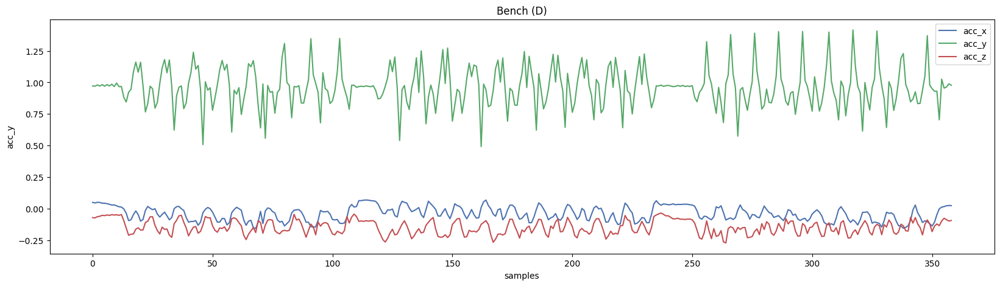

...

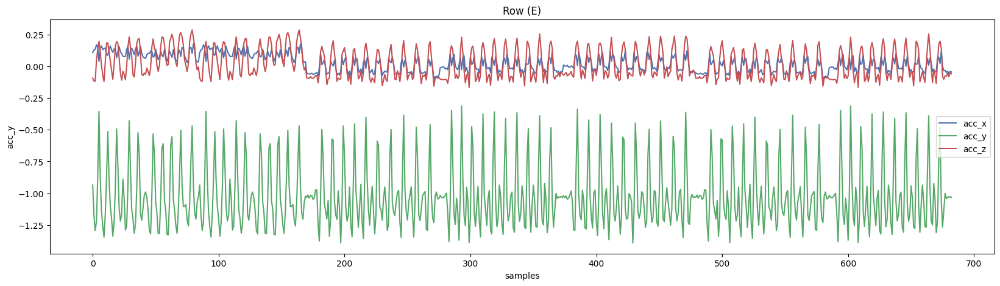

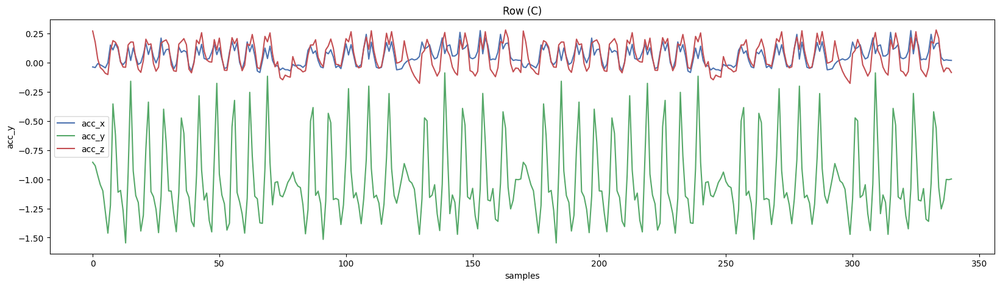

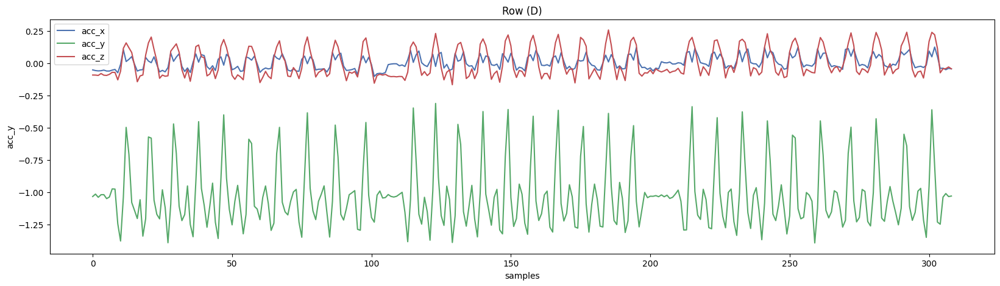

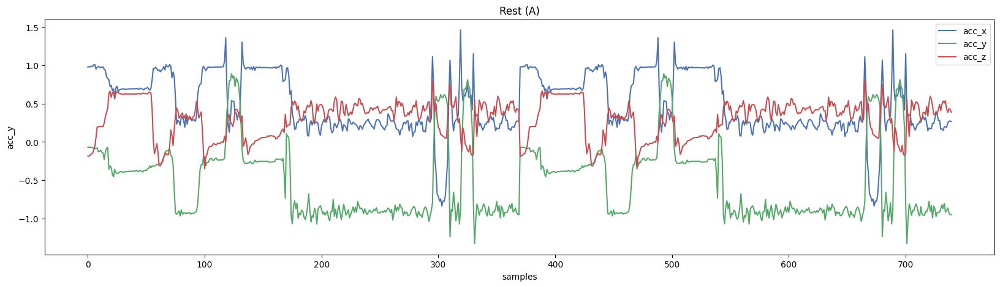

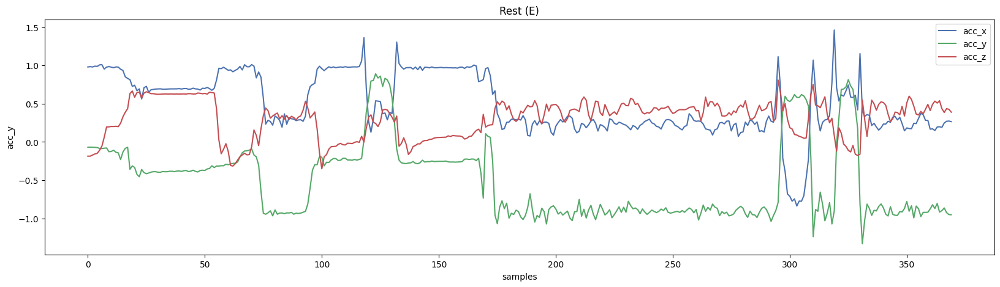

In [73]:
# 1. Get unique lists of all exercises and participants
labels = df["label"].unique()
participants = df["participant"].unique()

# 2. Nested Loop: Iterate through every Exercise -> then every Participant
for label in labels:
    for participant in participants:
        
        # 3. Filter data for this specific combination
        all_axis_df = (
            df.query(f"label == '{label}'")
              .query(f"participant == '{participant}'")
              .reset_index()
        )
        
        # 4. Only plot if data actually exists for this person/exercise combo
        if len(all_axis_df) > 0:
            
            fig, ax = plt.subplots()
            
            # 5. Plot all three accelerometer axes
            all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax)
            
            # 6. Add labels and a dynamic title
            ax.set_ylabel("acc_y")
            ax.set_xlabel("samples")
            plt.title(f"{label} ({participant})".title()) # .title() capitalizes the string
            plt.legend()
            plt.show()

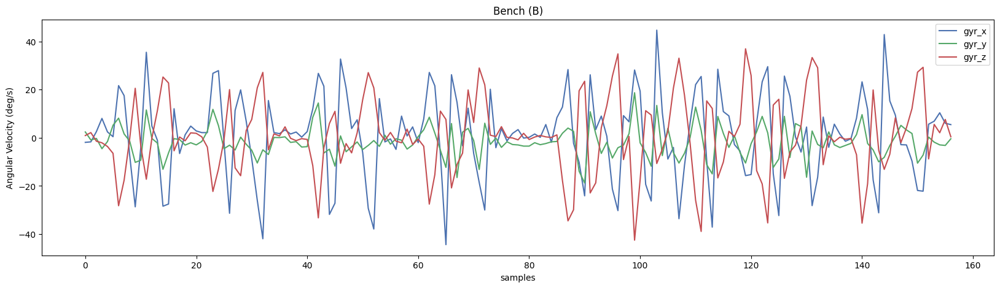

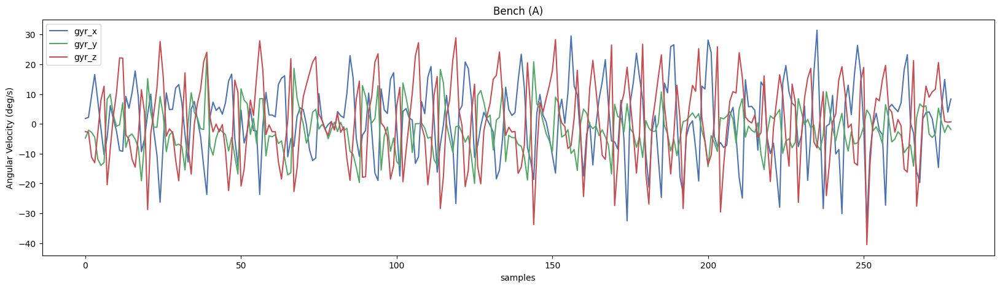

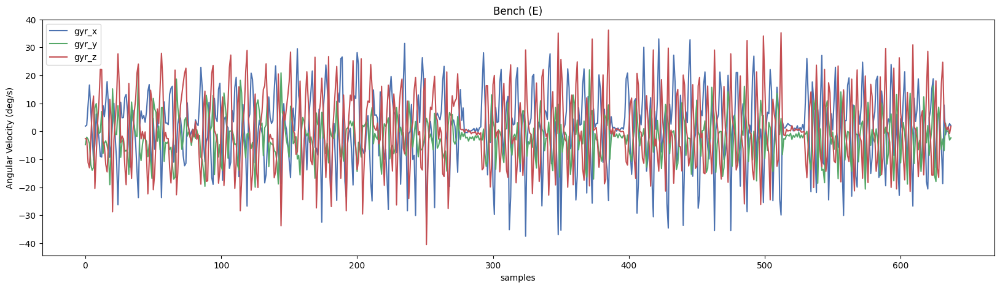

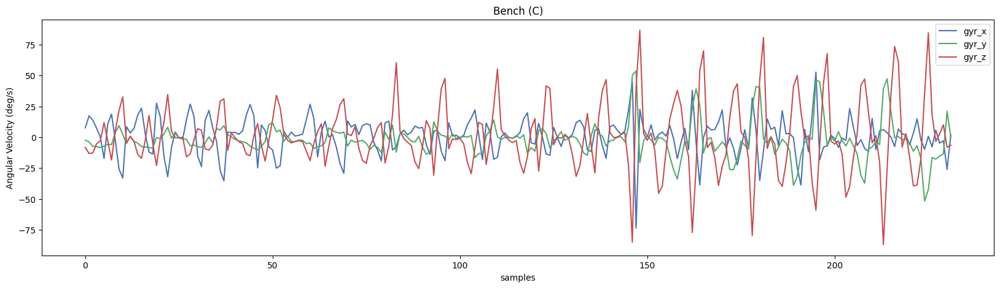

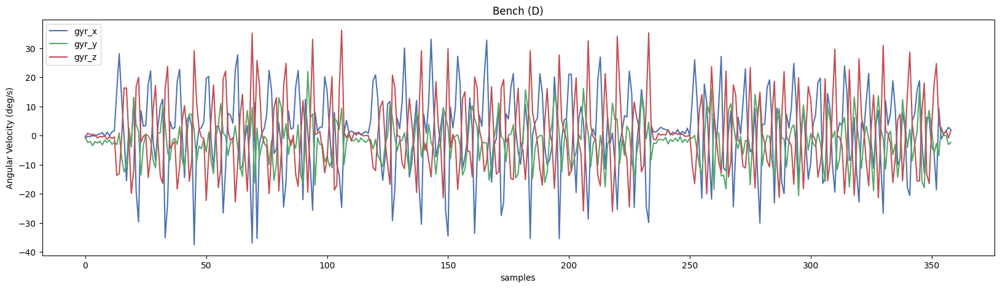

...

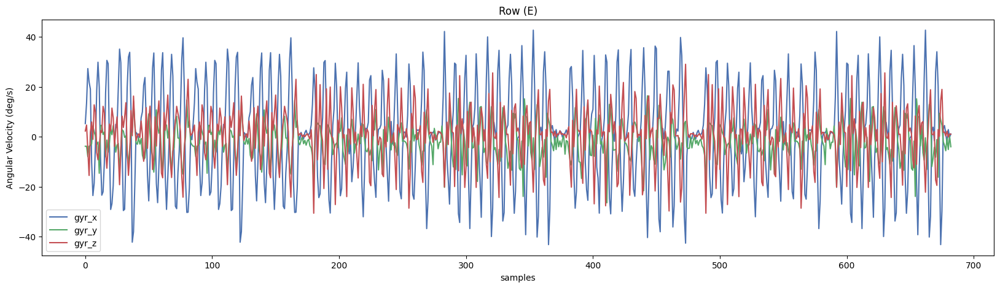

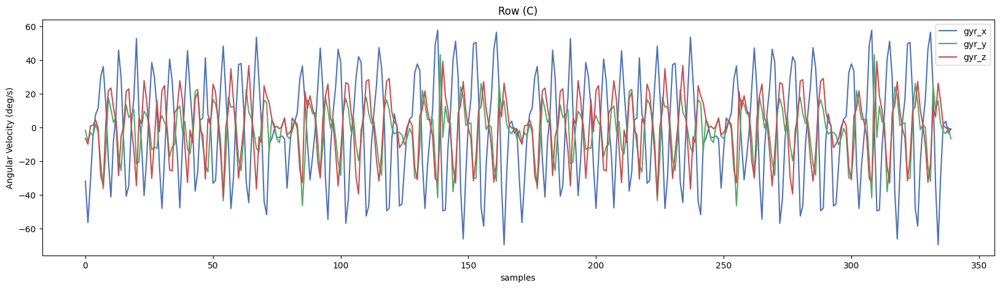

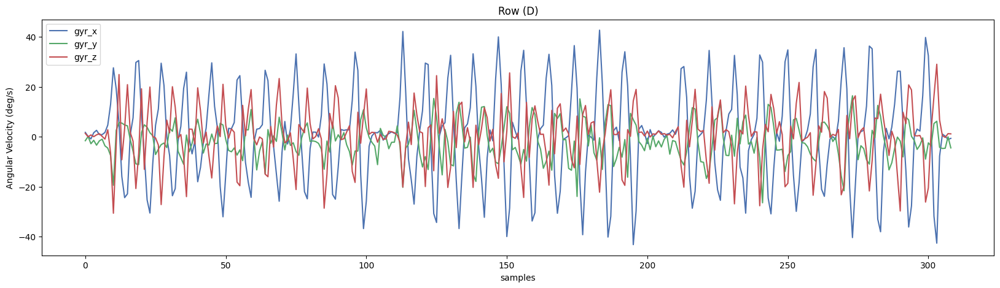

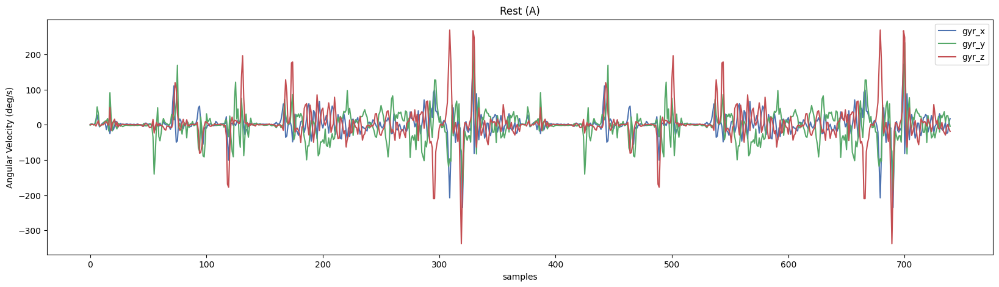

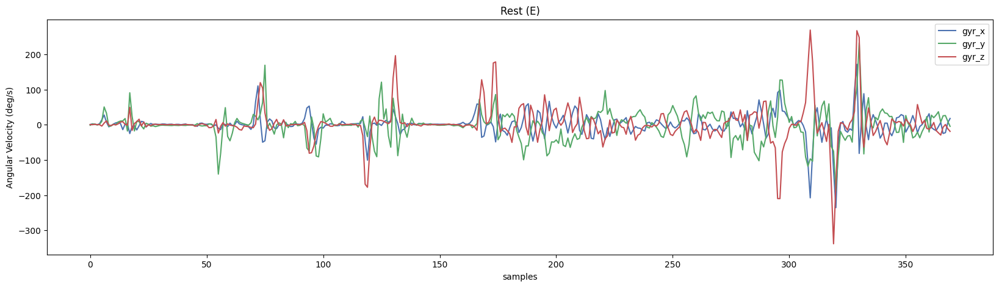

In [74]:
# 1. Get unique lists of all exercises and participants
labels = df["label"].unique()
participants = df["participant"].unique()

# 2. Nested Loop: Iterate through every Exercise -> then every Participant
for label in labels:
    for participant in participants:
        
        # 3. Filter data for this specific combination
        all_axis_df = (
            df.query(f"label == '{label}'")
              .query(f"participant == '{participant}'")
              .reset_index()
        )
        
        # 4. Only plot if data actually exists (length > 0)
        if len(all_axis_df) > 0:
            
            fig, ax = plt.subplots()
            
            # 5. Plot all three GYROSCOPE axes (gyr_x, gyr_y, gyr_z)
            all_axis_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax)
            
            # 6. Add labels and a dynamic title
            ax.set_ylabel("Angular Velocity (deg/s)")
            ax.set_xlabel("samples")
            plt.title(f"{label} ({participant})".title())
            plt.legend()
            plt.show()

# Combine plots in one figure

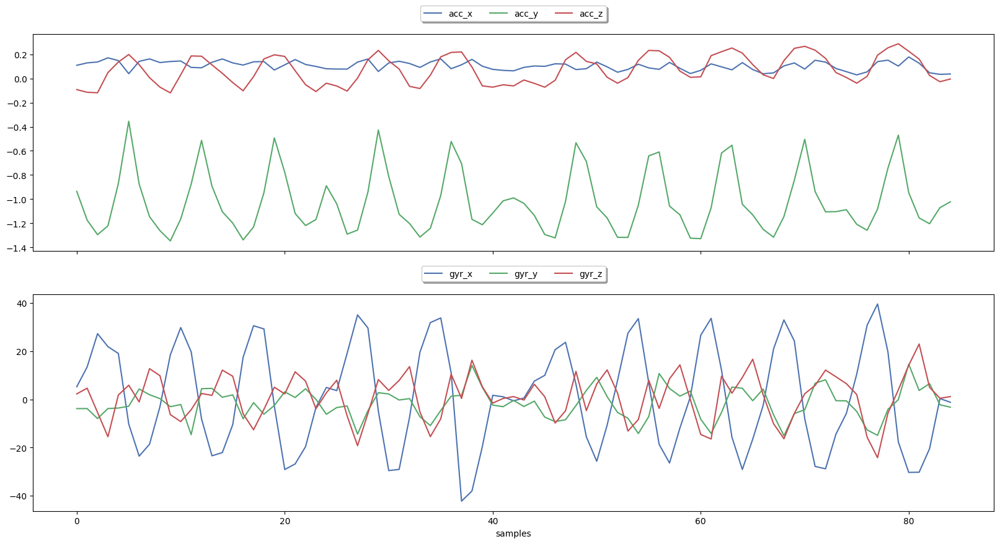

In [75]:
# 1. Define specific exercise and participant
label = "row"
participant = "A"

# 2. Filter the data for this specific combination
combined_plot_df = (
    df.query(f"label == '{label}'")
      .query(f"participant == '{participant}'")
      .reset_index(drop=True)
)

# 3. Create a figure with 2 rows (stacked vertically)
# sharex=True means if you zoom in on one plot, the other zooms automatically
fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))

# 4. Plot Accelerometer data on the Top Chart (ax[0])
combined_plot_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])

# 5. Plot Gyroscope data on the Bottom Chart (ax[1])
combined_plot_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])

# 6. Add fancy legends above the plots
# bbox_to_anchor moves the legend outside the chart so it doesn't cover data
ax[0].legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True)
ax[1].legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True)

# 7. Label the X-axis only on the bottom chart
ax[1].set_xlabel("samples")
plt.show()


# Loop over all combinations and export for both sensors


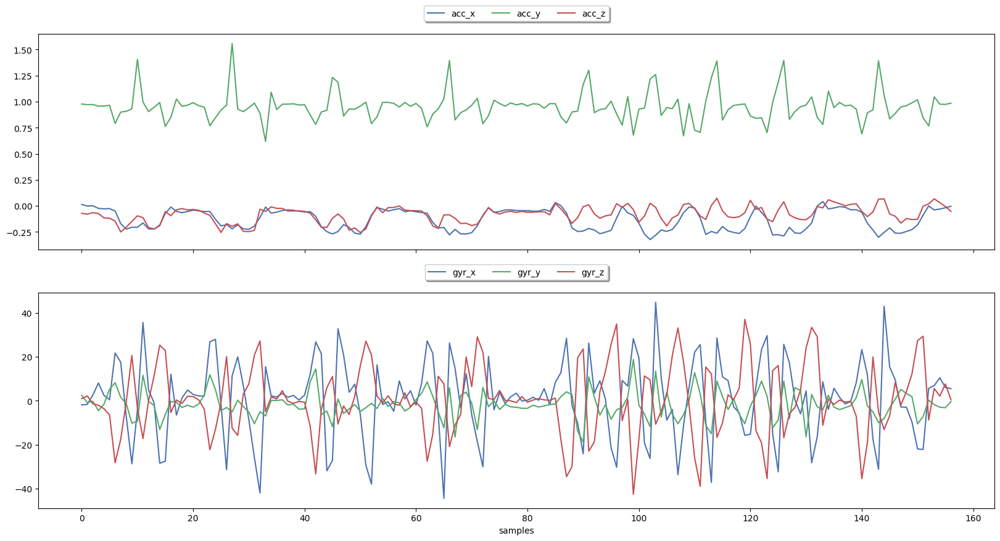

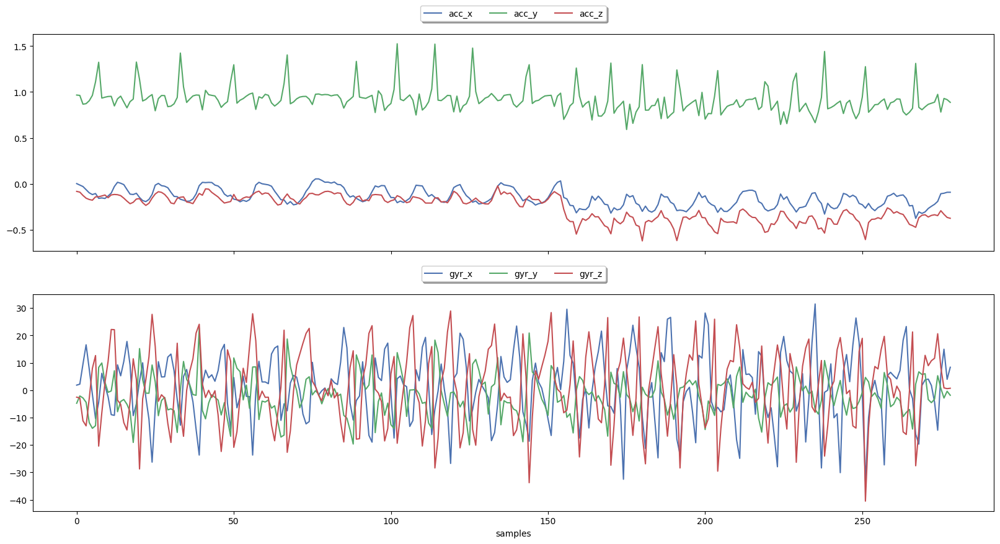

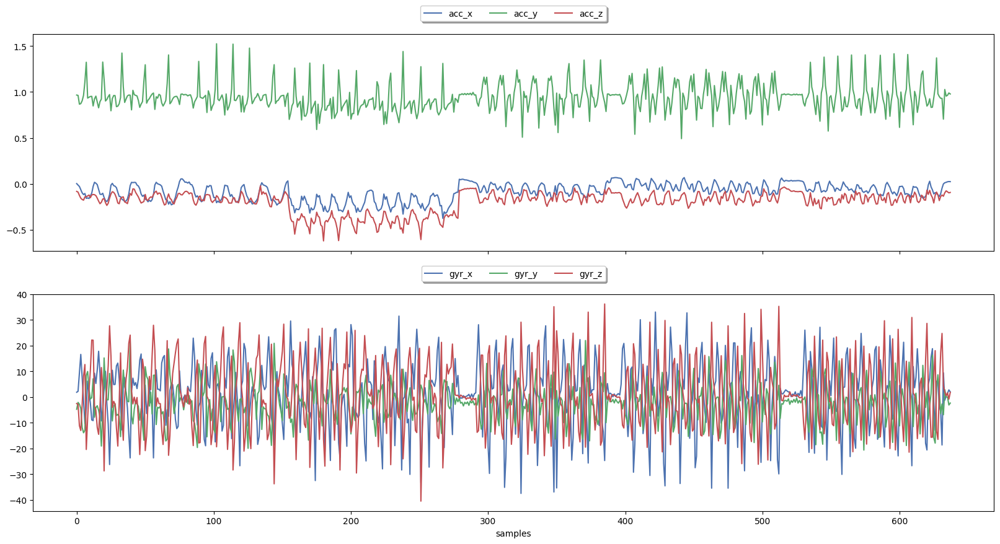

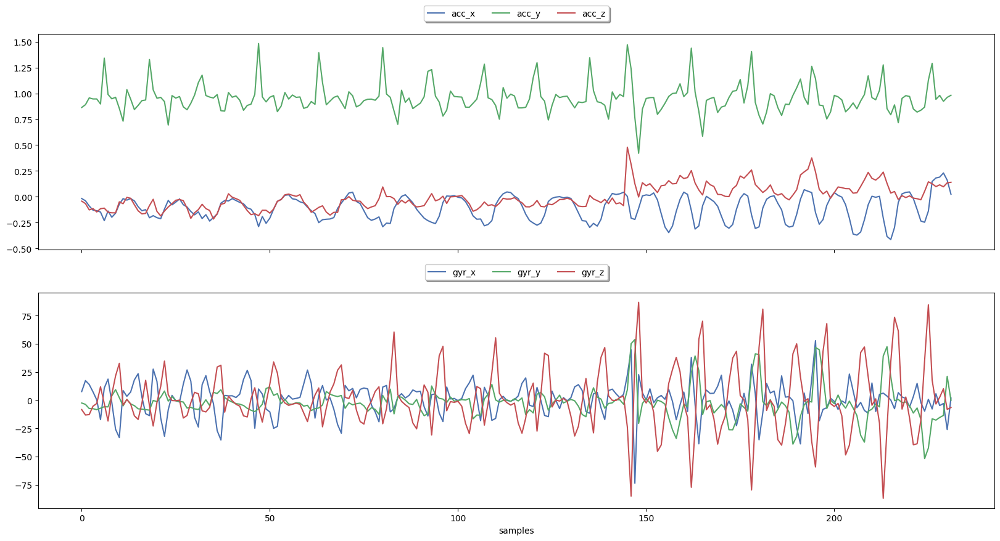

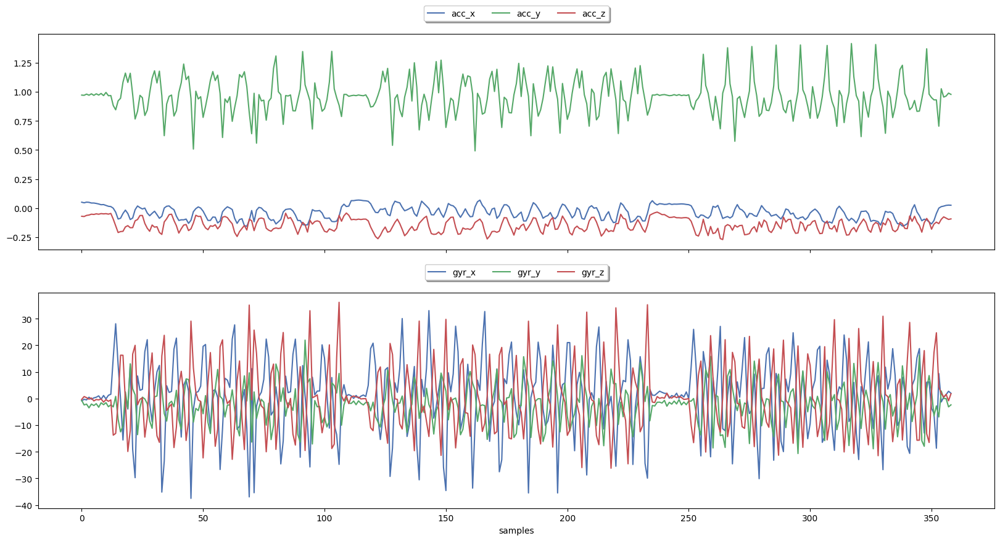

...

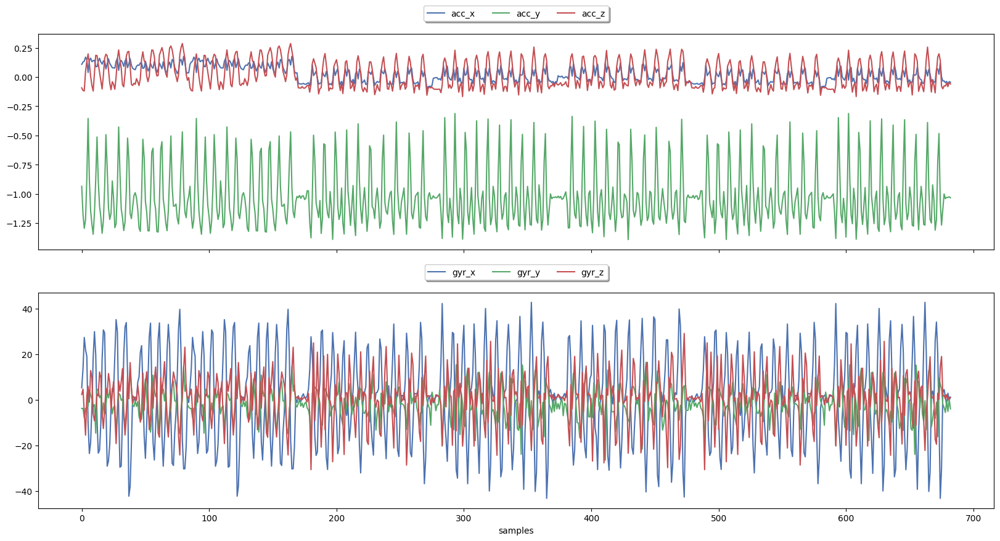

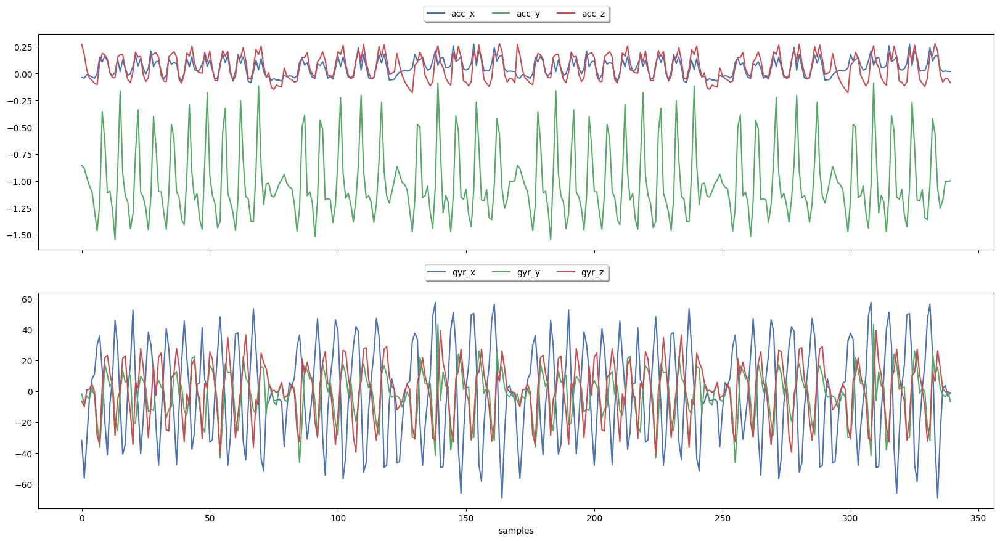

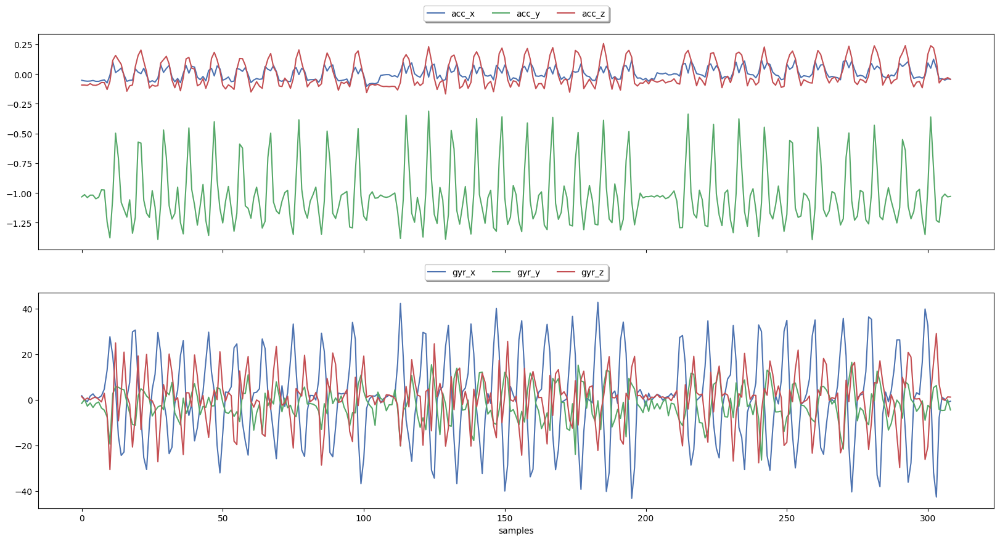

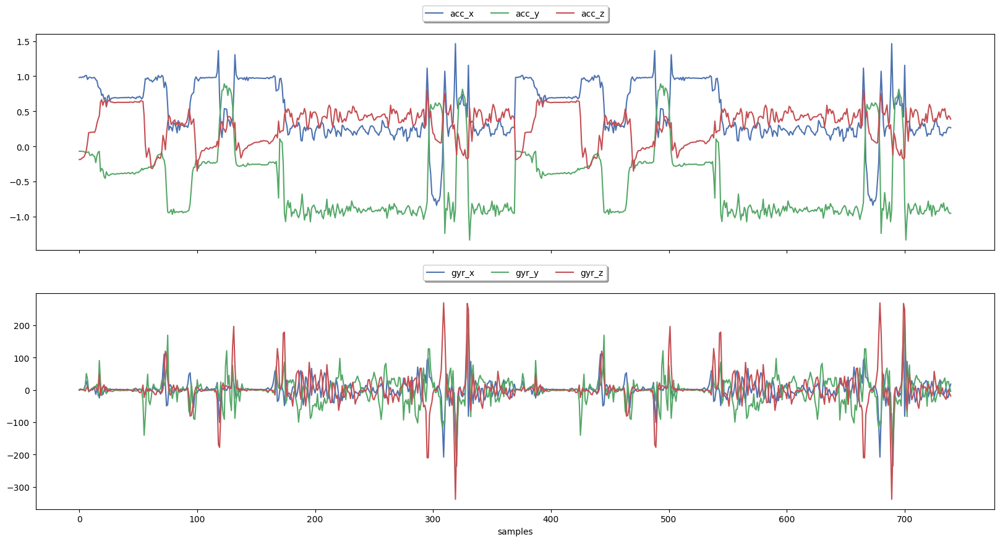

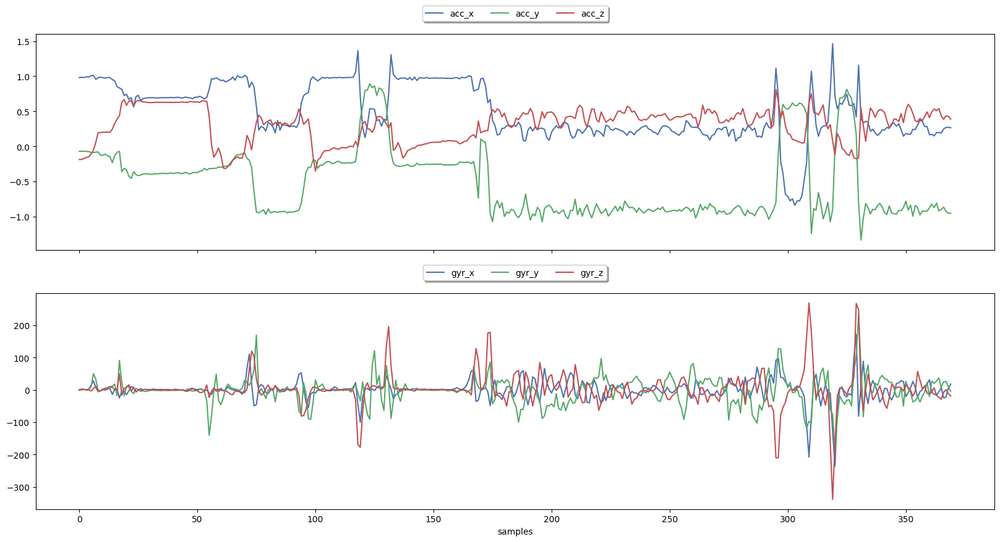

In [76]:
# 1. Get unique lists of exercises and participants
labels = df["label"].unique()
participants = df["participant"].unique()
# 2. Nested Loop: Iterate through every combination
for label in labels:
    for participant in participants:
        # 3. Filter the data
        combined_plot_df = (
            df.query(f"label == '{label}'")
              .query(f"participant == '{participant}'")
              .reset_index(drop=True)
        )
        # 4. Check if data exists
        if len(combined_plot_df) > 0:
            # 5. Create the stacked figure
            fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
            # 6. Plot Accelerometer (Top) and Gyroscope (Bottom)
            combined_plot_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
            combined_plot_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])
            # 7. Add Legends
            ax[0].legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True)
            ax[1].legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True)
            ax[1].set_xlabel("samples")
            # 8. SAVE THE FIGURE (The new part)
            # f-string creates a dynamic filename like "Squat (A).png"
            plt.savefig(f"../../reports/figures/{label.title()} ({participant}).png")
            # 9. Display the plot
            plt.show()